# **Eksploracyjna analiza dla danych zdjęciowych**

### Zbiory zostały połączone przy użyciu skryptu `data_handler.py`

## ŚCIEŻKI/IMPORTY/USTAWIENIA

In [1]:
IMAGES_DIR = "dataset_eda/images"
LABELS_DIR = "dataset_eda/labels.csv"

In [79]:
import os
import hashlib
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from PIL import Image
import imagehash

In [3]:
pd.options.display.float_format = '{:.3f}'.format

# **Uszkodzone dane**

In [4]:
corrupted = []

for img_name in os.listdir(IMAGES_DIR):
    try:
        img = Image.open(os.path.join(IMAGES_DIR, img_name))
        img.verify()
    except (IOError, SyntaxError) as e:
        corrupted.append(img_name)

In [5]:
print(len(corrupted))

0


# **Duplikaty**

In [6]:
def image_hash(path):
    with open(path, "rb") as f:
        return hashlib.md5(f.read()).hexdigest()

hashes = {}
duplicates = []

for img_name in os.listdir(IMAGES_DIR):
    h = image_hash(os.path.join(IMAGES_DIR, img_name))
    if h in hashes:
        duplicates.append((hashes[h], img_name))
    else:
        hashes[h] = img_name

In [7]:
print(len(duplicates))

0


# **Rozmiar**

## Wskaźniki statystyczne

In [8]:
size = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))

    height, width = img.shape[:2]

    size.append({
        "image": img_name,
        "width": width,
        "height": height,
        "aspect_ratio": round(width / height, 3),
        "area": width * height
    })

size_df = pd.DataFrame(size)

In [9]:
size_df.describe()

,width,height,aspect_ratio,area
count,11249.000,11249.000,11249.000,11249.000
mean,1354.063,873.936,1.464,1391566.264
std,702.715,318.303,0.379,1263290.847
min,238.000,158.000,0.750,37604.000
25%,640.000,640.000,1.000,409600.000
50%,1920.000,1080.000,1.778,2073600.000
75%,1920.000,1080.000,1.778,2073600.000
max,3840.000,4000.000,2.097,12000000.000


## Histogramy

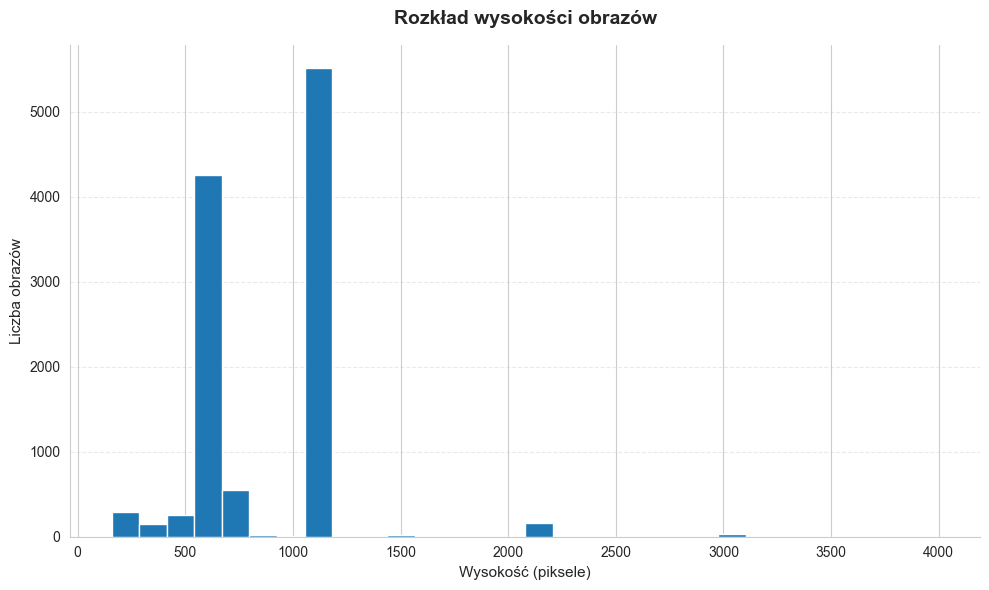

In [10]:
plt.figure(figsize=(10, 6))
plt.hist(size_df["height"], bins=30)
plt.ticklabel_format(style='plain', axis='x')
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.title("Rozkład wysokości obrazów", fontsize=14, pad=15, fontweight='bold')
plt.xlabel("Wysokość (piksele)", fontsize=11)
plt.ylabel("Liczba obrazów", fontsize=11)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

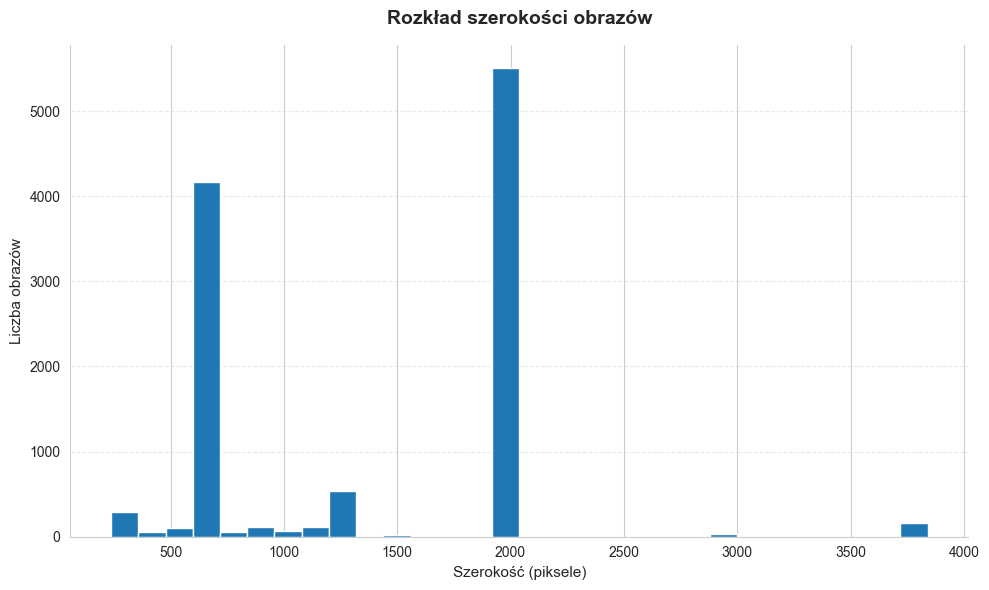

In [11]:
plt.figure(figsize=(10, 6))
plt.hist(size_df["width"], bins=30)
plt.ticklabel_format(style='plain', axis='x')
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.title("Rozkład szerokości obrazów", fontsize=14, pad=15, fontweight='bold')
plt.xlabel("Szerokość (piksele)", fontsize=11)
plt.ylabel("Liczba obrazów", fontsize=11)
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

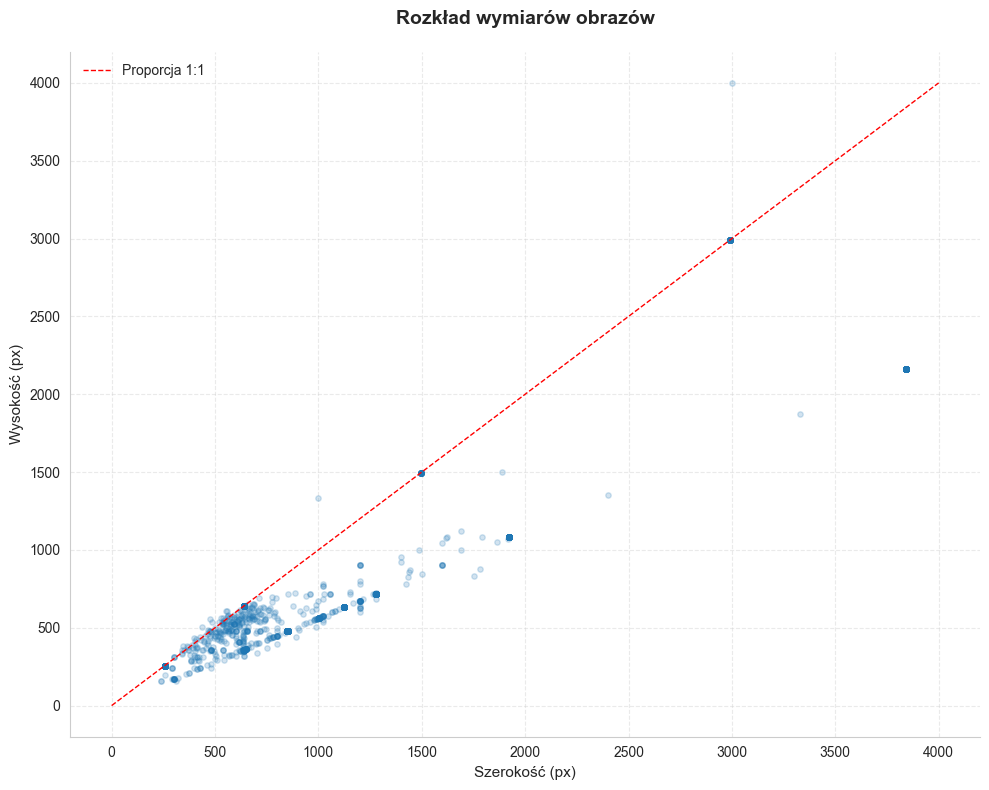

In [12]:
plt.figure(figsize=(10, 8))
plt.scatter(size_df["width"], size_df["height"], alpha=0.2, s=15)
max_dim = max(size_df["width"].max(), size_df["height"].max())
plt.plot([0, max_dim], [0, max_dim], color='red', linestyle='--', linewidth=1, label='Proporcja 1:1')
plt.ticklabel_format(style='plain', axis='both')
plt.grid(linestyle='--', alpha=0.4)
plt.xlabel("Szerokość (px)", fontsize=11)
plt.ylabel("Wysokość (px)", fontsize=11)
plt.title("Rozkład wymiarów obrazów", fontsize=14, pad=20, fontweight='bold')
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.legend(frameon=False)
plt.tight_layout()
plt.show()

## 5 najczęściej występujących rozdzielczości

In [13]:
top_5_res = size_df.groupby(['width', 'height']).size().reset_index(name='count')
top_5_res = top_5_res.sort_values('count', ascending=False).head(5)

print(top_5_res.to_string(index=False))

 width  height  count
  1920    1080   5504
   640     640   3997
  1280     720    499
   256     256    264
  3840    2160    167


In [14]:
top_5_examples = []

for _, row in top_5_res.iterrows():
    w = row["width"]
    h = row["height"]

    sample = size_df[
        (size_df["width"] == w) &
        (size_df["height"] == h)
    ].iloc[0]

    top_5_examples.append({
        "image": sample["image"],
        "width": w,
        "height": h,
        "count": row["count"]
    })

top_5_examples_df = pd.DataFrame(top_5_examples)

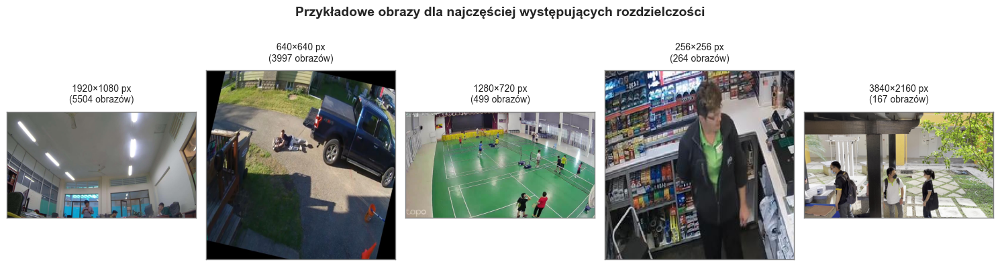

In [15]:
plt.figure(figsize=(15, 4))

for i, row in top_5_examples_df.iterrows():
    img = cv2.imread(os.path.join(IMAGES_DIR, row["image"]))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 5, i + 1)
    plt.imshow(img)

    plt.title(
        f"{row['width']}×{row['height']} px\n({row['count']} obrazów)", fontsize=10, pad=10
    )

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(1)


plt.suptitle("Przykładowe obrazy dla najczęściej występujących rozdzielczości", fontsize=14, fontweight='bold',y=1.05)
plt.tight_layout()
plt.show()

## Skrajne przypadki

In [16]:
max_min_area = size_df[(size_df["area"] == 12000000) | (size_df["area"] == 37604)]
max_min_area = max_min_area[["image", "area"]]
max_min_area

,image,area
2408,image_02409.jpg,12000000
5373,image_05374.jpg,37604
8420,image_08421.jpg,37604


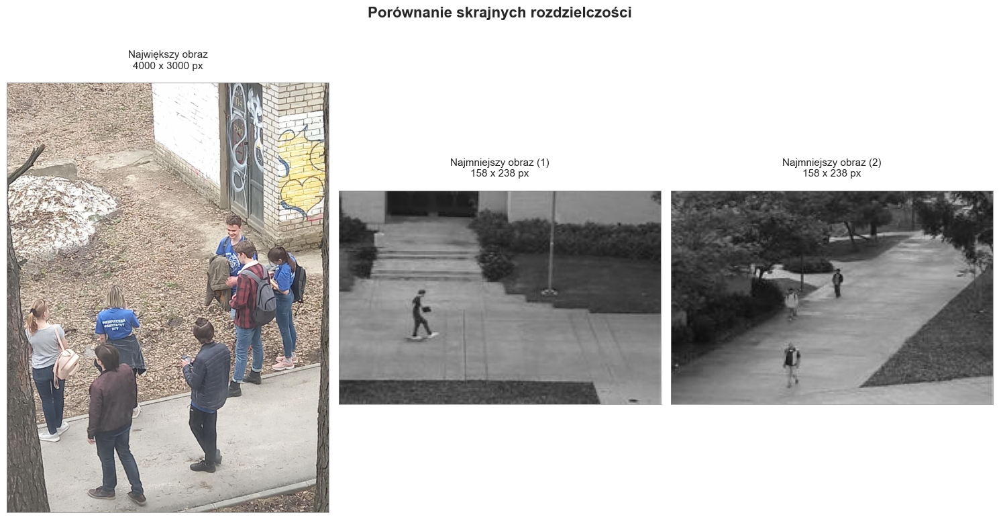

In [17]:
img_max = cv2.imread(os.path.join(IMAGES_DIR, "image_02409.jpg"))
img_min1 = cv2.imread(os.path.join(IMAGES_DIR, "image_05374.jpg"))
img_min2 = cv2.imread(os.path.join(IMAGES_DIR, "image_08421.jpg"))
img_max = cv2.cvtColor(img_max, cv2.COLOR_BGR2RGB)
img_min1 = cv2.cvtColor(img_min1, cv2.COLOR_BGR2RGB)
img_min2 = cv2.cvtColor(img_min2, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 8))

images = [img_max, img_min1, img_min2]
titles = ["Największy obraz", "Najmniejszy obraz (1)", "Najmniejszy obraz (2)"]

for i, (img, title) in enumerate(zip(images, titles)):
    ax = plt.subplot(1, 3, i + 1)
    plt.imshow(img)

    ax.set_title(f"{title}\n{img.shape[0]} x {img.shape[1]} px", fontsize=11, pad=15)

    ax.set_xticks([])
    ax.set_yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(0.5)


plt.suptitle("Porównanie skrajnych rozdzielczości", fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

# **Aspect ratio**

## Wskaźniki statystyczne

In [18]:
aspect_ratio = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))

    height, width = img.shape[:2]

    aspect_ratio.append({
        "image": img_name,
        "aspect_ratio": round(width / height, 3)
    })

aspect_ratio_df = pd.DataFrame(aspect_ratio)

In [19]:
aspect_ratio_df.describe()

,aspect_ratio
count,11249.000
mean,1.464
std,0.379
min,0.750
25%,1.000
50%,1.778
75%,1.778
max,2.097


## Histogram

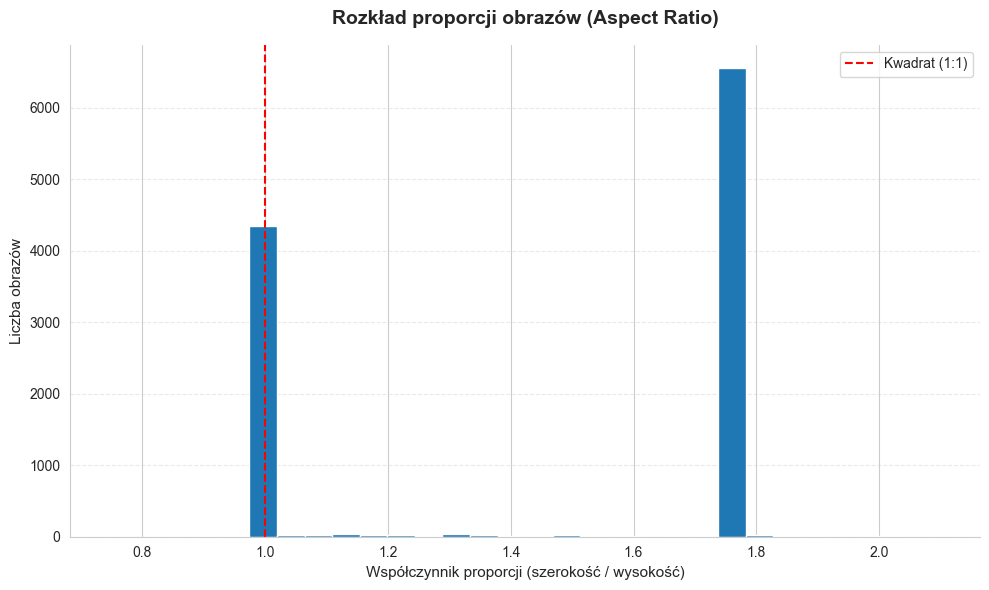

In [20]:
plt.figure(figsize=(10, 6))
plt.hist(aspect_ratio_df["aspect_ratio"], bins=30)
plt.axvline(1.0, color="red", linestyle="--", linewidth=1.5, label="Kwadrat (1:1)")
plt.ticklabel_format(style='plain', axis='y')
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.title("Rozkład proporcji obrazów (Aspect Ratio)", fontsize=14, pad=15, fontweight='bold')
plt.xlabel("Współczynnik proporcji (szerokość / wysokość)", fontsize=11)
plt.ylabel("Liczba obrazów", fontsize=11)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.legend()
plt.tight_layout()
plt.show()

## Przykładowe zdjęcia

In [21]:
high_aspect_ratio = aspect_ratio_df[aspect_ratio_df["aspect_ratio"] > 2]
low_aspect_ratio = aspect_ratio_df[aspect_ratio_df["aspect_ratio"] < 1]

In [22]:
high_aspect_ratio

,image,aspect_ratio
5494,image_05495.jpg,2.034
5561,image_05562.jpg,2.089
5663,image_05664.jpg,2.033
5669,image_05670.jpg,2.097
5683,image_05684.jpg,2.023
5719,image_05720.jpg,2.025


In [23]:
low_aspect_ratio

,image,aspect_ratio
2258,image_02259.jpg,0.991
2262,image_02263.jpg,0.936
2269,image_02270.jpg,0.963
2301,image_02302.jpg,0.965
2339,image_02340.jpg,0.998
2408,image_02409.jpg,0.750
2687,image_02688.jpg,0.860
2978,image_02979.jpg,0.899
2982,image_02983.jpg,0.971
3003,image_03004.jpg,0.922


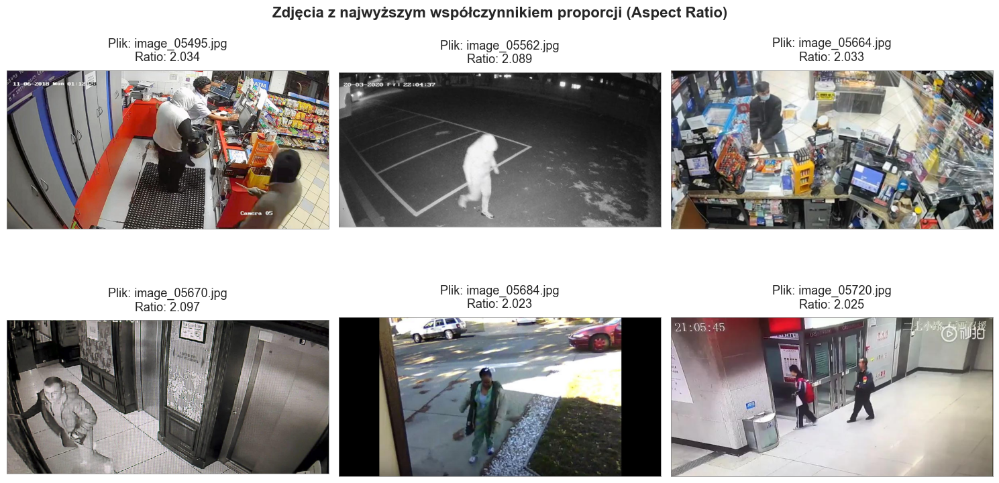

In [24]:
plt.figure(figsize=(15, 10))

for i, row in enumerate(high_aspect_ratio.head(6).itertuples()):
    img = cv2.imread(os.path.join(IMAGES_DIR, row.image))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(2, 3, i + 1)
    plt.imshow(img)

    title_text = f"Plik: {row.image}\nRatio: {row.aspect_ratio:.3f}"
    ax.set_title(title_text, fontsize=13, pad=10)

    ax.set_xticks([])
    ax.set_yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(0.5)


plt.suptitle("Zdjęcia z najwyższym współczynnikiem proporcji (Aspect Ratio)", fontsize=16, fontweight='bold', y=0.87)
plt.tight_layout(rect=(0, 0.03, 1, 0.95))
plt.show()

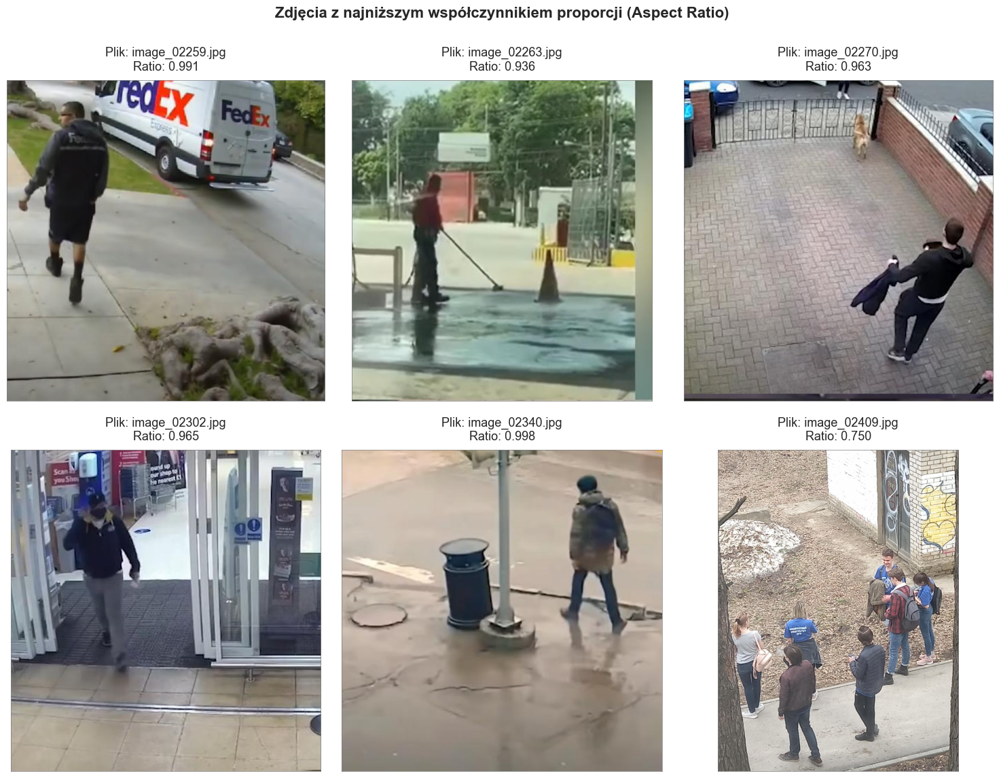

In [25]:
plt.figure(figsize=(15, 12))

for i, row in enumerate(low_aspect_ratio.head(6).itertuples()):
    img = cv2.imread(os.path.join(IMAGES_DIR, row.image))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(2, 3, i + 1)
    plt.imshow(img)

    title_text = f"Plik: {row.image}\nRatio: {row.aspect_ratio:.3f}"
    ax.set_title(title_text, fontsize=13, pad=10)

    ax.set_xticks([])
    ax.set_yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(0.5)


plt.suptitle("Zdjęcia z najniższym współczynnikiem proporcji (Aspect Ratio)", fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout(rect=(0, 0.03, 1, 0.95), h_pad=4.0)
plt.show()

# **Kanały kolorów**

## Weryfikacja formatu

In [26]:
formats = {
    "GRAYSCALE": 0,
    "RGB": 0,
    "RGBA": 0,
    "INNE": 0
}

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name), cv2.IMREAD_UNCHANGED)

    if len(img.shape) == 2:
        formats["GRAYSCALE"] += 1

    elif len(img.shape) == 3:
        if img.shape[2] == 3:
            formats["RGB"] += 1
        elif img.shape[2] == 4:
            formats["RGBA"] += 1
        else:
            formats["INNE"] += 1

In [27]:
print(f"GRAYSCALE: {formats['GRAYSCALE']}\nRGB: {formats['RGB']}\nRGBA: {formats['RGBA']}\nINNE: {formats['INNE']}")

GRAYSCALE: 0
RGB: 11249
RGBA: 0
INNE: 0


## Wskaźniki statystyczne

In [28]:
sum_r = sum_g = sum_b = 0
sum_sq_r = sum_sq_g = sum_sq_b = 0
pixels = 0

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))

    img = img.astype(np.float32)

    b,g,r = cv2.split(img)

    sum_r += r.sum()
    sum_b += b.sum()
    sum_g += g.sum()

    sum_sq_r += (r**2).sum()
    sum_sq_g += (g**2).sum()
    sum_sq_b += (b**2).sum()

    pixels += b.size


mean_r = sum_r / pixels
mean_g = sum_g / pixels
mean_b = sum_b / pixels

std_r = np.sqrt(sum_sq_r / pixels - mean_r**2)
std_g = np.sqrt(sum_sq_g / pixels - mean_g**2)
std_b = np.sqrt(sum_sq_b / pixels - mean_b**2)

In [29]:
print(f"Mean\nR: {mean_r:.3f}\nG: {mean_g:.3f}\nB: {mean_b:.3f}")
print(f"Std\nR: {std_r:.3f}\nG: {std_g:.3f}\nB: {std_b:.3f}")

Mean
R: 117.982
G: 118.985
B: 115.382
Std
R: 60.405
G: 60.703
B: 61.649


In [30]:
grayscale_like = 0
total = 0

threshold = 2

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = img.astype(np.float32)

    b, g, r = cv2.split(img)

    diff_rg = np.abs(r - g).mean()
    diff_rb = np.abs(r - b).mean()
    diff_gb = np.abs(g - b).mean()

    mean_diff = (diff_rg + diff_rb + diff_gb) / 3

    if mean_diff < threshold:
        grayscale_like += 1

    total += 1

In [31]:
print("Czarno-białe obrazy:", grayscale_like)
print("Procent całego zbioru:", round(100 * grayscale_like / total, 2), "%")

Czarno-białe obrazy: 2156
Procent całego zbioru: 19.17 %


## Dekompozycja

In [32]:
def decomposition(img_name):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    r, g, b = cv2.split(img)
    zeros = np.zeros(r.shape, dtype="uint8")

    red_img = cv2.merge([r, zeros, zeros])
    green_img = cv2.merge([zeros, g, zeros])
    blue_img = cv2.merge([zeros, zeros, b])

    fig, axes = plt.subplots(1, 4, figsize=(20, 6))

    titles = ["Oryginał", "Kanał Czerwony (R)", "Kanał Zielony (G)", "Kanał Niebieski (B)"]
    images = [img, red_img, green_img, blue_img]

    for ax, image, title in zip(axes, images, titles):
        ax.imshow(image)
        ax.set_title(title, fontsize=14, pad=10)
        ax.set_xticks([])
        ax.set_yticks([])
        for spine in ax.spines.values():
            spine.set_visible(True)
            spine.set_color("lightgray")


    plt.suptitle(f"Dekompozycja obrazu: {img_name}", fontsize=18, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.show()

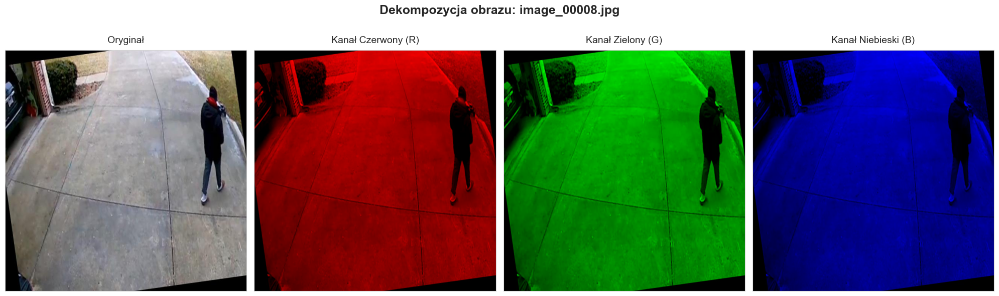

In [33]:
decomposition("image_00008.jpg")

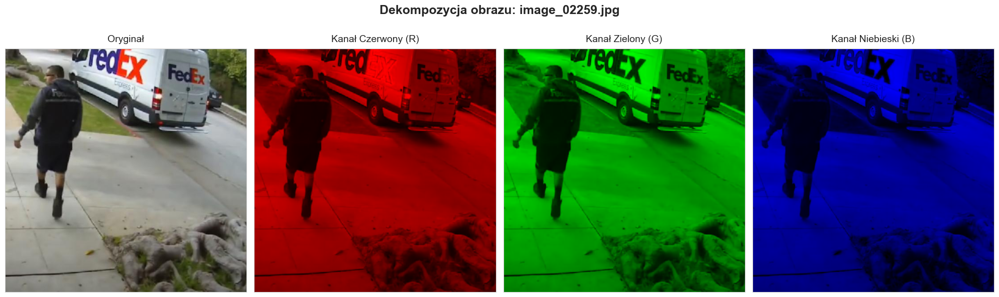

In [34]:
decomposition("image_02259.jpg")

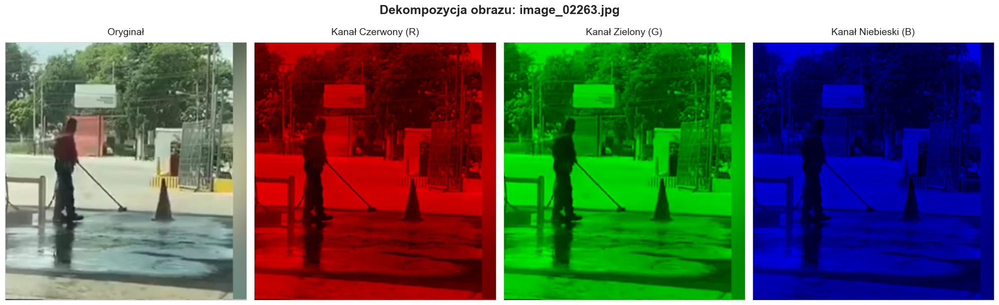

In [35]:
decomposition("image_02263.jpg")

## Histogram

In [36]:
hist_b = np.zeros(256)
hist_g = np.zeros(256)
hist_r = np.zeros(256)

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))

    b,g,r = cv2.split(img)

    hist_b += np.histogram(b, bins=256, range=(0,255))[0]
    hist_g += np.histogram(g, bins=256, range=(0,255))[0]
    hist_r += np.histogram(r, bins=256, range=(0,255))[0]


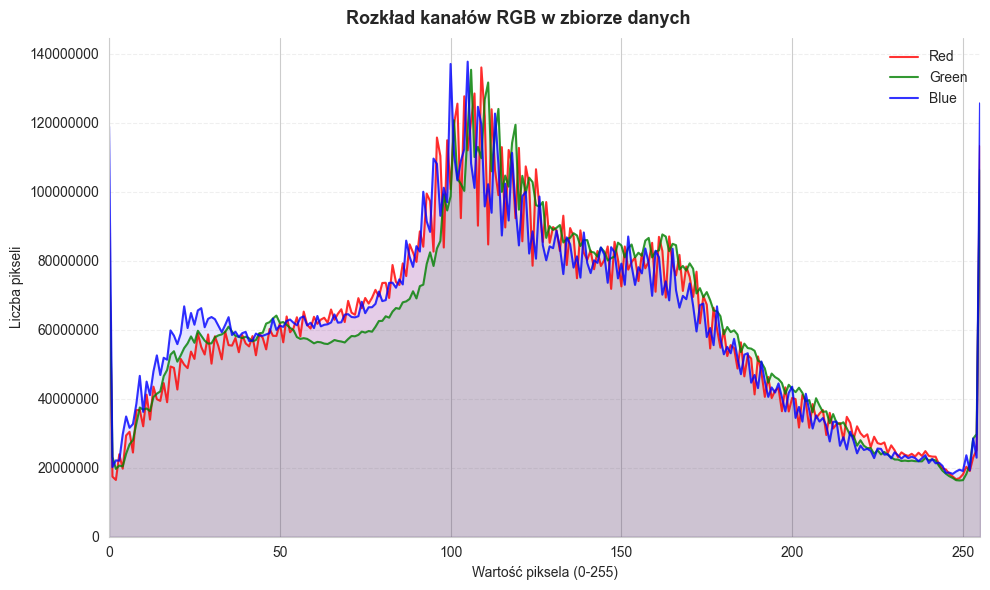

In [37]:
plt.figure(figsize=(10, 6))

plt.plot(hist_r, color='red', label="Red", alpha=0.8, linewidth=1.5)
plt.fill_between(range(256), hist_r, color='red', alpha=0.1)

plt.plot(hist_g, color='green', label="Green", alpha=0.8, linewidth=1.5)
plt.fill_between(range(256), hist_g, color='green', alpha=0.1)

plt.plot(hist_b, color='blue', label="Blue", alpha=0.8, linewidth=1.5)
plt.fill_between(range(256), hist_b, color='blue', alpha=0.1)

plt.ticklabel_format(style='plain', axis='y')
plt.xlim(0, 255)
plt.ylim(bottom=0)

plt.grid(axis='y', linestyle='--', alpha=0.3)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.ylabel("Liczba pikseli", fontsize=10)
plt.xlabel("Wartość piksela (0-255)", fontsize=10)
plt.title("Rozkład kanałów RGB w zbiorze danych", fontsize=13, pad=10, fontweight='bold', x=0.47)
plt.legend(frameon=False)

plt.tight_layout()
plt.show()

## Skrajne przypadki

In [38]:
blue = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    b, g, r = cv2.split(img)

    dark_blue_ratio = (b <= 5).mean()
    bright_blue_ratio = (b >= 250).mean()

    blue.append({
        "image": img_name,
        "dark_blue_ratio": dark_blue_ratio,
        "bright_blue_ratio": bright_blue_ratio
    })

blue_df = pd.DataFrame(blue)

In [39]:
dark_blue_imgs = blue_df.sort_values("dark_blue_ratio", ascending=False).head(6)
bright_blue_imgs = blue_df.sort_values("bright_blue_ratio", ascending=False).head(6)

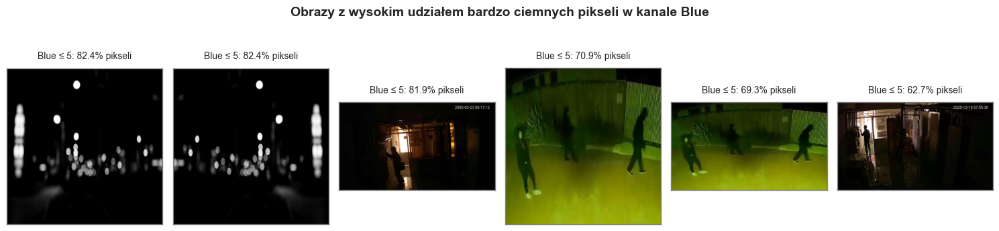

In [40]:
plt.figure(figsize=(15, 4))

for i, img_name in enumerate(dark_blue_imgs["image"]):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 6, i + 1)
    plt.imshow(img)

    score = dark_blue_imgs.iloc[i]["dark_blue_ratio"] * 100
    plt.title(f"Blue ≤ 5: {score:.1f}% pikseli", fontsize=10, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(1)

plt.suptitle("Obrazy z wysokim udziałem bardzo ciemnych pikseli w kanale Blue", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

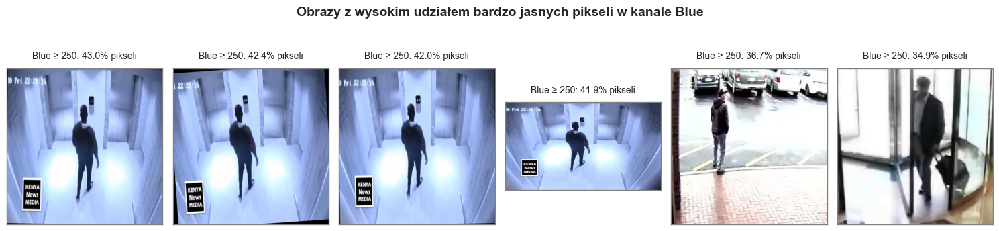

In [41]:
plt.figure(figsize=(15, 4))

for i, img_name in enumerate(bright_blue_imgs["image"]):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 6, i + 1)
    plt.imshow(img)

    score = bright_blue_imgs.iloc[i]["bright_blue_ratio"] * 100
    plt.title(f"Blue ≥ 250: {score:.1f}% pikseli", fontsize=10, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(1)

plt.suptitle("Obrazy z wysokim udziałem bardzo jasnych pikseli w kanale Blue", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## Korelacja

In [42]:
channel_pixels = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))

    b,g,r = cv2.split(img)
    channel_pixels.append([
        r.mean(),
        g.mean(),
        b.mean(),
    ])

In [43]:
channel_df = pd.DataFrame(channel_pixels, columns=["R","G","B"])
corr = channel_df.select_dtypes('number').corr()

In [44]:
corr

,R,G,B
R,1.000,0.955,0.896
G,0.955,1.000,0.956
B,0.896,0.956,1.000


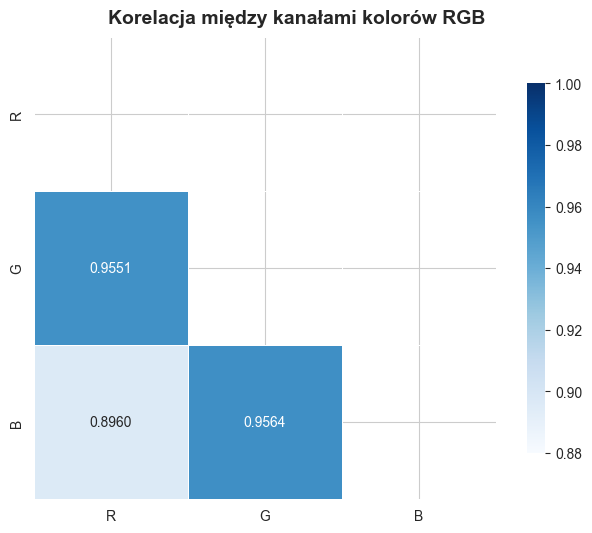

In [45]:
mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(8, 6))

sns.heatmap(
    corr,
    mask=mask,
    annot=True,
    fmt=".4f",
    cmap="Blues",
    vmin=0.88,
    vmax=1.0,
    center=0.94,
    square=True,
    linewidths=.5,
    cbar_kws={"shrink": .8}
)

plt.title("Korelacja między kanałami kolorów RGB", fontsize=14, pad=10, fontweight='bold', x=0.57)
plt.show()

# **Jasność**

## Wskaźniki statystyczne

In [46]:
p5, p95 = [], []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    p5.append(np.percentile(gray, 5))
    p95.append(np.percentile(gray, 95))

In [47]:
dynamic_ranges = [high - low for high, low in zip(p95, p5)]

avg_p5 = np.mean(p5)
avg_p95 = np.mean(p95)
avg_range = np.mean(dynamic_ranges)

In [48]:
print(f"Średni 5. percentyl (cienie): {avg_p5:.23}")
print(f"Średni 95. percentyl (światła): {avg_p95:.23}")
print(f"Średnia szerokość tonalna (kontrast): {avg_range:.23}")

Średni 5. percentyl (cienie): 26.29911103209174427775
Średni 95. percentyl (światła): 204.5579518179393119226
Średnia szerokość tonalna (kontrast): 178.25884078584758185571


In [49]:
dark_images = [i for i, val in enumerate(p95) if val < 50]
flat_images = [i for i, val in enumerate(dynamic_ranges) if val < 40]

print(f"Liczba obrazów bardzo ciemnych: {len(dark_images)}")
print(f"Liczba obrazów o niskim kontraście: {len(flat_images)}")

Liczba obrazów bardzo ciemnych: 1
Liczba obrazów o niskim kontraście: 3


In [50]:
print(dark_images)

[10802]


## Histogramy

In [51]:
p5 = []
p95 = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    p5.append(np.percentile(gray, 5))
    p95.append(np.percentile(gray, 95))

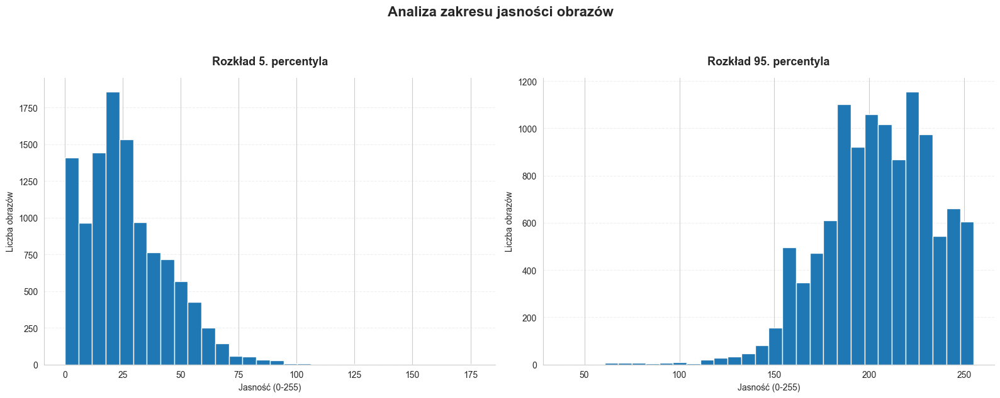

In [52]:
plt.figure(figsize=(16, 6))

ax1 = plt.subplot(1, 2, 1)
plt.hist(p5, bins=30)
plt.title("Rozkład 5. percentyla", fontsize=13, fontweight='bold', pad=15)
plt.xlabel("Jasność (0-255)")
plt.ylabel("Liczba obrazów")
plt.grid(axis='y', linestyle='--', alpha=0.3)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)

ax2 = plt.subplot(1, 2, 2)
plt.hist(p95, bins=30)
plt.title("Rozkład 95. percentyla", fontsize=13, fontweight='bold', pad=15)
plt.xlabel("Jasność (0-255)")
plt.ylabel("Liczba obrazów")
plt.grid(axis='y', linestyle='--', alpha=0.3)
ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)

plt.suptitle("Analiza zakresu jasności obrazów", fontsize=16, fontweight='bold', y=1.05)
plt.tight_layout()
plt.show()

In [53]:
hist_gray = np.zeros(256)

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    hist_gray += np.histogram(gray, bins=256, range=(0,255))[0]

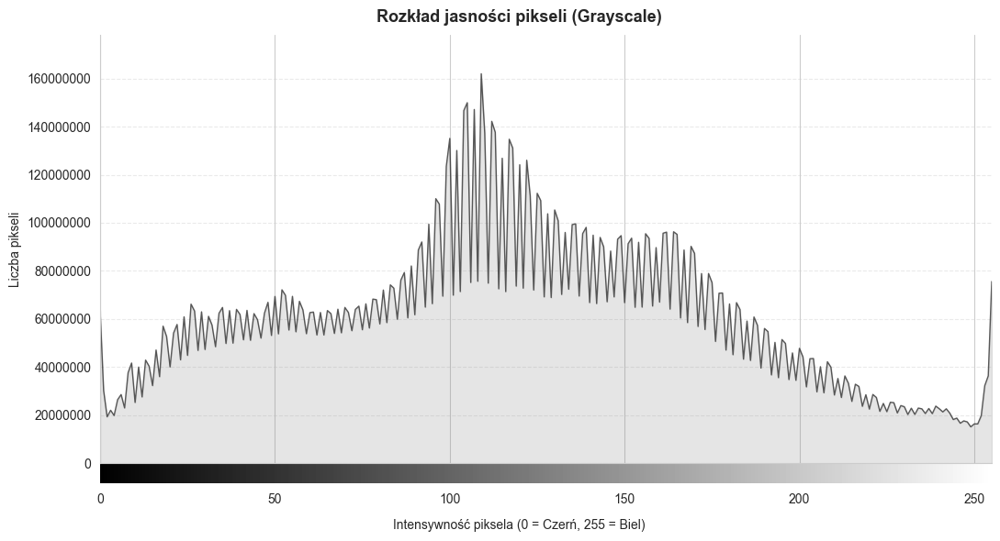

In [54]:
plt.figure(figsize=(11, 6))
ax = plt.gca()
plt.plot(hist_gray, color="#333333", linewidth=1, alpha=0.8)
plt.fill_between(range(256), hist_gray, color="gray", alpha=0.2)
plt.xlim(0, 255)
max_val = max(hist_gray)
plt.ylim(0, max_val * 1.1)
plt.ticklabel_format(style='plain', axis='y')
height = max_val * 0.05
gradient = np.linspace(0, 255, 256).reshape(1, 256)
plt.imshow(gradient, aspect='auto', cmap='gray', extent=(0, 255, -height, 0), clip_on=False)
plt.grid(axis='y', linestyle='--', alpha=0.4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.title("Rozkład jasności pikseli (Grayscale)", fontsize=13, pad=10, fontweight='bold', x=0.47)
plt.xlabel("Intensywność piksela (0 = Czerń, 255 = Biel)", fontsize=10, labelpad=10, x=0.47)
plt.ylabel("Liczba pikseli", fontsize=10)
ax.tick_params(axis='x', which='major', pad=20)
plt.ylim(0, max_val * 1.1)
plt.tight_layout()
plt.show()

In [55]:
brightness = []

for img_name in os.listdir(IMAGES_DIR):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    brightness.append(gray.mean())

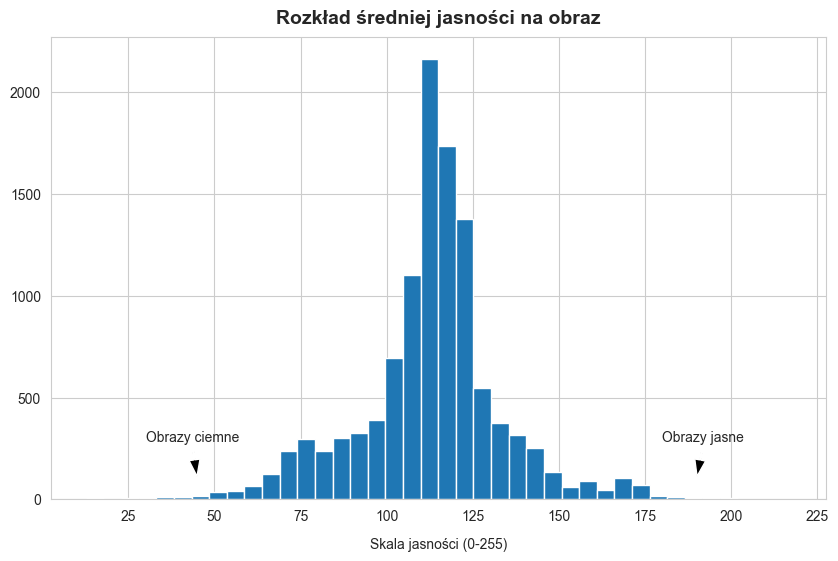

In [56]:
plt.figure(figsize=(10, 6))
plt.hist(brightness, bins=40)
plt.xlabel("Skala jasności (0-255)", fontsize=10, labelpad=10)
plt.annotate('Obrazy ciemne', xy=(45, 105), xytext=(30, 285), arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=8))
plt.annotate('Obrazy jasne', xy=(190, 105), xytext=(180, 285), arrowprops=dict(facecolor='black', shrink=0.05, width=1, headwidth=8))
plt.title("Rozkład średniej jasności na obraz", fontsize=14, pad=10, fontweight='bold')
plt.show()

## Skrajne przypadki

In [57]:
brightness_example = []

for img_name in os.listdir(IMAGES_DIR):
    path = os.path.join(IMAGES_DIR, img_name)

    img = cv2.imread(path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    brightness_example.append({
        "image": img_name,
        "brightness": gray.mean()
    })

bright_df = pd.DataFrame(brightness_example)

In [58]:
dark = bright_df.sort_values("brightness").head(6)
bright = bright_df.sort_values("brightness", ascending=False).head(6)

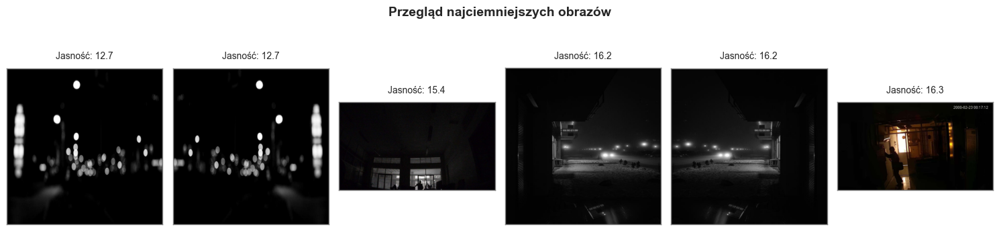

In [59]:
plt.figure(figsize=(15, 4))

for i, img_name in enumerate(dark["image"]):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 6, i + 1)
    plt.imshow(img)

    plt.title(f"Jasność: {dark.iloc[i]['brightness']:.1f}", fontsize=10, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color('gray')
        spine.set_linewidth(1)


plt.suptitle("Przegląd najciemniejszych obrazów", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

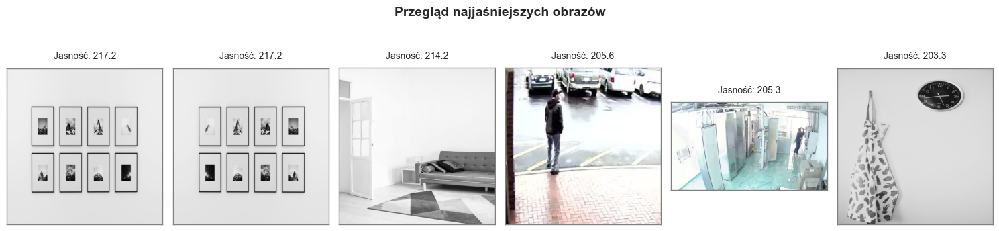

In [60]:
plt.figure(figsize=(15, 4))

for i, img_name in enumerate(bright["image"]):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 6, i + 1)
    plt.imshow(img)

    plt.title(f"Jasność: {bright.iloc[i]['brightness']:.1f}", fontsize=10, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color('gray')
        spine.set_linewidth(1)


plt.suptitle("Przegląd najjaśniejszych obrazów", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

# **Etykiety**

In [61]:
labels_df = pd.read_csv(LABELS_DIR)
objects_per_image = labels_df.groupby("image_id").size()

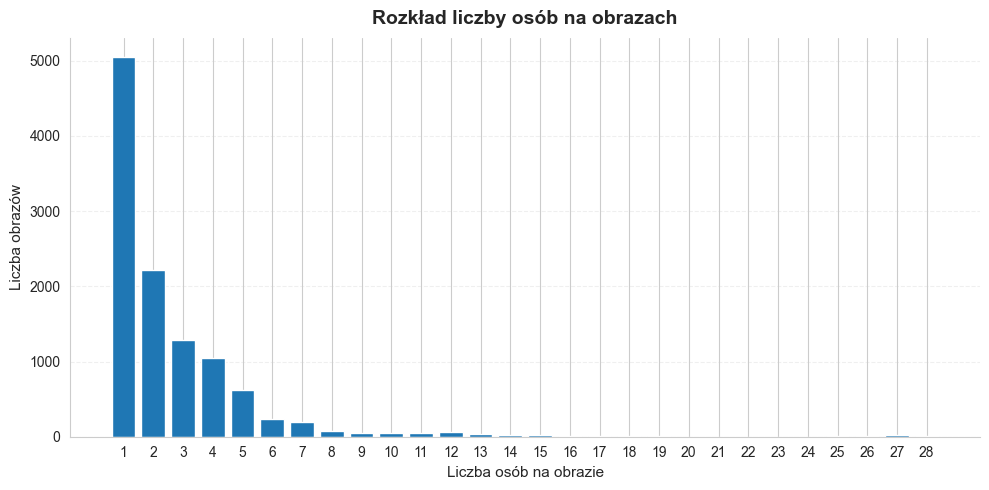

In [62]:
plt.figure(figsize=(10, 5))
plt.hist(objects_per_image, bins=range(1, objects_per_image.max() + 2), align="left", rwidth=0.8)
plt.grid(axis='y', linestyle='--', alpha=0.3)
plt.xlabel("Liczba osób na obrazie", fontsize=11)
plt.ylabel("Liczba obrazów", fontsize=11)
plt.title("Rozkład liczby osób na obrazach", fontsize=14, pad=10, fontweight='bold')
ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.xticks(range(1, objects_per_image.max() + 1))
plt.tight_layout()
plt.show()

In [63]:
labels_df = pd.read_csv(LABELS_DIR)

all_images = len(os.listdir(IMAGES_DIR))
images_with_people = labels_df["image_id"].nunique()
images_without_people = all_images - images_with_people

print(f"Wszystkie obrazy: {all_images}")
print(f"Obrazy z osobami: {images_with_people}")
print(f"Obrazy bez osób: {images_without_people}")

Wszystkie obrazy: 11249
Obrazy z osobami: 11086
Obrazy bez osób: 163


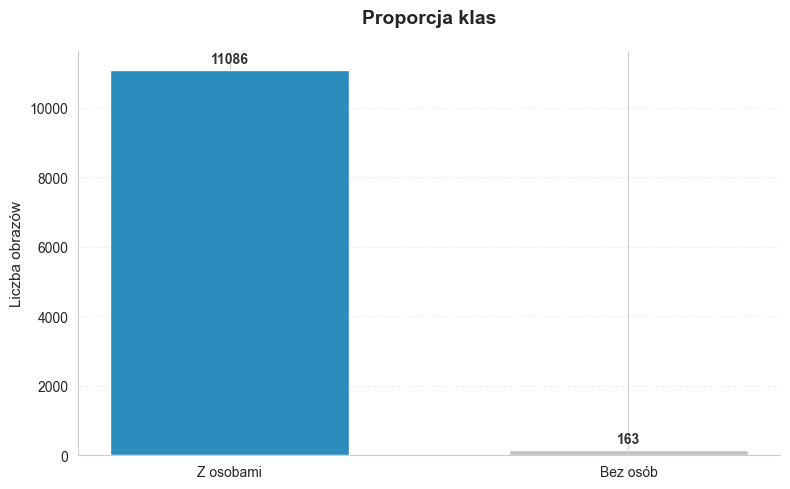

In [64]:
plt.figure(figsize=(8, 5))

bars = plt.bar(
    ["Z osobami", "Bez osób"],
    [images_with_people, images_without_people],
    color=["#2b8cbe", "#bdc3c7"],
    width=0.6
)

plt.grid(axis='y', linestyle='--', alpha=0.3)
plt.ylabel("Liczba obrazów", fontsize=11)
plt.title("Proporcja klas", fontsize=14, pad=20, fontweight='bold')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + (max(images_with_people, images_without_people) * 0.01),
             f'{int(yval)}', ha='center', va='bottom', fontsize=10, fontweight='bold', color='#333333')

ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

In [65]:
labeled_ids = set(labels_df["image_id"].unique())

no_person_images = []

for img_name in os.listdir(IMAGES_DIR):
    image_id = int(img_name.split("_")[1].split(".")[0])
    if image_id not in labeled_ids:
        no_person_images.append(img_name)

## Przegląd zdjęć bez etykiet (bounding box'ów)

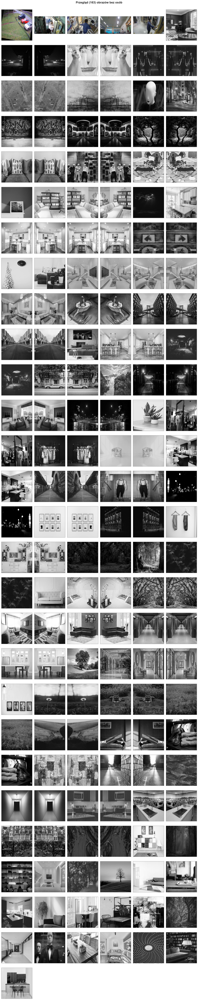

In [66]:
plt.figure(figsize=(15, 75))

no_person_images_examples = no_person_images[:163]

for i, img_name in enumerate(no_person_images_examples):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(28, 6, i + 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")


plt.suptitle("Przegląd (163) obrazów bez osób", fontsize=16, fontweight='bold', y=1.0001)
plt.tight_layout()
plt.show()

## Anomalie

In [67]:
anomalies = no_person_images[1:5]
anomalies

['image_03865.jpg', 'image_04177.jpg', 'image_04995.jpg', 'image_07943.jpg']

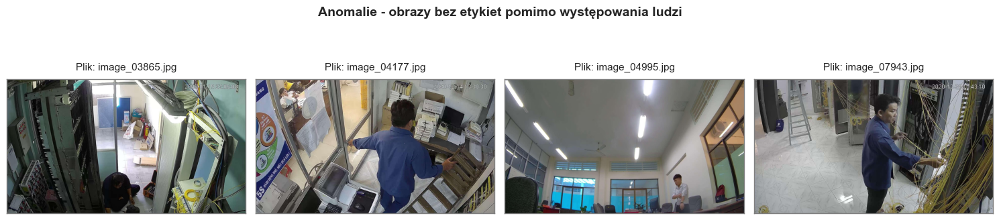

In [68]:
plt.figure(figsize=(15, 4))

for i, img_name in enumerate(anomalies):
    img = cv2.imread(os.path.join(IMAGES_DIR, img_name))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax = plt.subplot(1, 4, i + 1)
    plt.imshow(img)

    plt.title(f"Plik: {img_name}", fontsize=11, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color('gray')
        spine.set_linewidth(1)


plt.suptitle("Anomalie - obrazy bez etykiet pomimo występowania ludzi", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## Wizualizacja bounding box'ów

In [69]:
def draw_bboxes(img, boxes):
    h, w = img.shape[:2]

    for _, row in boxes.iterrows():
        xc = row["x_center"] * w
        yc = row["y_center"] * h
        bw = row["width"] * w
        bh = row["height"] * h

        x1 = int(xc - bw / 2)
        y1 = int(yc - bh / 2)
        x2 = int(xc + bw / 2)
        y2 = int(yc + bh / 2)

        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

    return img

In [70]:
labels_df = pd.read_csv(LABELS_DIR)

sample_ids = labels_df["image_id"].sample(6, random_state=42)

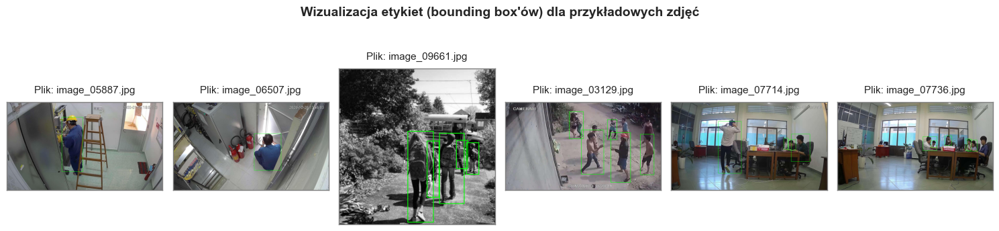

In [71]:
plt.figure(figsize=(15, 4))

for i, image_id in enumerate(sample_ids):

    img_name = f"image_{image_id:05d}.jpg"
    img_path = os.path.join(IMAGES_DIR, img_name)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    boxes = labels_df[labels_df["image_id"] == image_id]

    img_boxed = draw_bboxes(img.copy(), boxes)

    ax = plt.subplot(1, 6, i + 1)
    plt.imshow(img_boxed)
    plt.title(f"Plik: {img_name}", fontsize=11, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(1)


plt.suptitle("Wizualizacja etykiet (bounding box'ów) dla przykładowych zdjęć", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

In [72]:
max_people = objects_per_image.max()
max_people

np.int64(28)

In [73]:
extreme_ids = objects_per_image[objects_per_image == max_people].index.tolist()
extreme_ids

[6847, 9506, 9514]

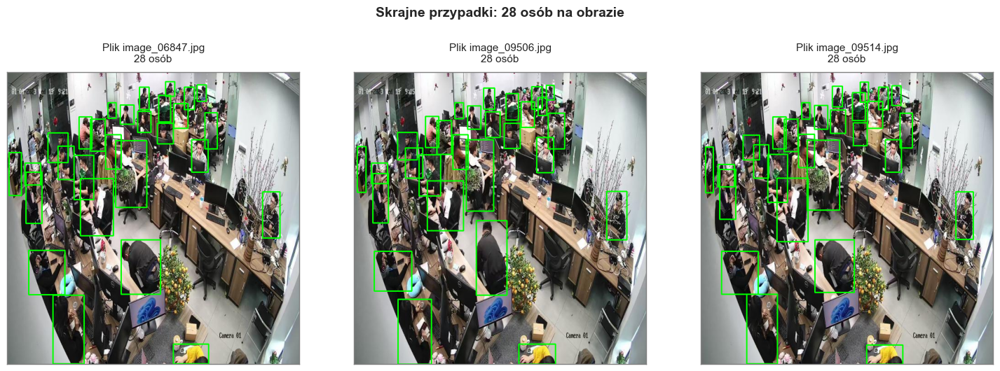

In [74]:
plt.figure(figsize=(15, 5))

for i, image_id in enumerate(extreme_ids):

    img_name = f"image_{image_id:05d}.jpg"
    img_path = os.path.join(IMAGES_DIR, img_name)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    boxes = labels_df[labels_df["image_id"] == image_id]
    img_boxed = draw_bboxes(img.copy(), boxes)

    ax = plt.subplot(1, len(extreme_ids), i + 1)
    plt.imshow(img_boxed)
    plt.title(f"Plik {img_name}\n{max_people} osób", fontsize=11, pad=10)

    plt.xticks([])
    plt.yticks([])

    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color("gray")
        spine.set_linewidth(1)


plt.suptitle("Skrajne przypadki: 28 osób na obrazie", fontsize=14, fontweight='bold', y=1.05)
plt.tight_layout()
plt.show()